In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
from pathlib import Path
from tqdm import tqdm
import numpy as np
import torch
from torch.utils.data import DataLoader
from torch.nn import CTCLoss
import matplotlib.pyplot as plt
import seaborn as sns
import json
import pickle
from typing import Any, Optional, Literal
from collections import OrderedDict
import re
import editdistance

import sys
sys.path.append("..")

from OCR.line_OCR.ctc.models_line_ctc import Decoder
from basic.models import FCN_Encoder
from basic.generic_dataset_manager import OCRDataset, OCRCollateFunction
from basic.utils import edit_wer_from_str, nb_words_from_str, LM_ind_to_str

import matplotlib_inline
%matplotlib inline
matplotlib_inline.backend_inline.set_matplotlib_formats('pdf', 'svg')

sns.set_theme(style="darkgrid")

C:\Users\valer\anaconda3\lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated and will be removed in a future release
  "class": algorithms.Blowfish,


In [3]:
def savefig(name, add_pdf=False):
    path = rf"C:\Users\valer\Desktop\mmp_courses\scientific_work\m1p\slides\middle_talk\images\{name}"
    if add_pdf:
        path = path + ".pdf"
    plt.savefig(path, bbox_inches='tight')

In [4]:
class LineVAN(torch.nn.Module):
    def __init__(
        self,
        model_params: dict[str, Any],
        encoder_state_dict: Optional[OrderedDict] = None,
        decoder_state_dict: Optional[OrderedDict] = None
    ):
        super().__init__()
        self.encoder = FCN_Encoder(model_params)
        self.decoder = Decoder(model_params)
        if encoder_state_dict is not None:
            self.encoder.load_state_dict(encoder_state_dict)
        else:
            print("encoder_state_dict is None")
        if decoder_state_dict is not None:
            self.decoder.load_state_dict(decoder_state_dict)
        else:
            print("decoder_state_dict is None")

    def forward(self, x):
        x = self.encoder(x)
        return self.decoder(x)

In [5]:
def get_tokens(params: dict[str, Any], charset: set[str]) -> dict[str, int]:
    """
    see: https://github.com/valerazykov/VerticalAttentionOCR/blob/master/basic/generic_dataset_manager.py#L76
    
    params: dataset_params
    """
    tokens = {
        "pad": params["config"]["padding_token"],
    }
    if params["config"]["charset_mode"].lower() == "ctc":
        tokens["blank"] = len(charset)
        tokens["pad"] = tokens["pad"] if tokens["pad"] else len(charset) + 1
        params["config"]["padding_token"] = tokens["pad"]
    elif params["config"]["charset_mode"] == "attention":
        tokens["end"] = len(charset)
        tokens["start"] = len(charset) + 1
        tokens["pad"] = tokens["pad"] if tokens["pad"] else len(charset) + 2
        if params["config"]["pad_label_with_end_token"]:
            params["config"]["padding_token"] = tokens["end"]
        else:
            params["config"]["padding_token"] = tokens["pad"]

    return tokens

In [6]:
def ctc_remove_successives_identical_ind(ind):
    res = []
    for i in ind:
        if res and res[-1] == i:
            continue
        res.append(i)
    return res

In [7]:
def get_str_xy(x, y, x_len, y_len):
    """
    see compute_metrics func
    """
    batch_size = y.shape[0]
    ind_x = [x[i][:x_len[i]] for i in range(batch_size)]
    ind_y = [y[i][:y_len[i]] for i in range(batch_size)]
    ind_x = [ctc_remove_successives_identical_ind(t) for t in ind_x]
    str_x = [LM_ind_to_str(charset, t, oov_symbol="") for t in ind_x]
    str_y = [LM_ind_to_str(charset, t) for t in ind_y]
    str_x = [re.sub("( )+", ' ', t).strip(" ") for t in str_x]

    return str_x, str_y

In [8]:
device = torch.device(
    "cuda:0" if torch.cuda.is_available()
    else "cpu"
)
device

device(type='cuda', index=0)

## Модель v6.1

In [37]:
dataset_path = "../Datasets/formatted/SK_lines"
checkpoint_path = "../OCR/line_OCR/ctc/outputs/SK_line_v6.1/checkpoints/weigths_1000.pt"
params_path = "../OCR/line_OCR/ctc/outputs/SK_line_v6.1/results/params"

In [38]:
checkpoint = torch.load(checkpoint_path)

In [39]:
list(checkpoint.keys())

['optimizer_state_dict',
 'epoch',
 'apex_state_dict',
 'best',
 'curriculum_config',
 'encoder_state_dict',
 'decoder_state_dict']

In [40]:
checkpoint["epoch"], checkpoint["best"], checkpoint["curriculum_config"]

(1000, 0.1824, None)

In [41]:
with open(params_path, 'r') as params_file:
    params = json.load(params_file)

In [42]:
params

{'dataset_params': {'random_seed': 120,
  'datasets': {'SK': '../../../Datasets/formatted/SK_lines'},
  'train': {'name': 'SK-train', 'datasets': ['SK']},
  'valid': {'SK-valid': ['SK']},
  'dataset_class': 'OCRDataset',
  'config': {'width_divisor': 8,
   'height_divisor': 32,
   'padding_value': 0,
   'padding_token': 1000,
   'charset_mode': 'CTC',
   'constraints': ['CTC_line', 'padding'],
   'padding': {'min_height': 168, 'min_width': 2452},
   'preprocessings': [{'type': 'dpi', 'source': 200, 'target': 150},
    {'type': 'to_RGB'}],
   'augmentation': {'dpi': {'proba': 0.2,
     'min_factor': 0.75,
     'max_factor': 1.25},
    'perspective': {'proba': 0.2, 'min_factor': 0, 'max_factor': 0.3},
    'elastic_distortion': {'proba': 0.2, 'max_magnitude': 20, 'max_kernel': 3},
    'random_transform': {'proba': 0.2, 'max_val': 16},
    'dilation_erosion': {'proba': 0.2,
     'min_kernel': 1,
     'max_kernel': 3,
     'iterations': 1},
    'brightness': {'proba': 0.2, 'min_factor': 0.0

In [43]:
model = LineVAN(
    params["model_params"],
    encoder_state_dict=checkpoint["encoder_state_dict"],
    decoder_state_dict=checkpoint["decoder_state_dict"]
).to(device)

In [44]:
labels_path = "../Datasets/formatted/SK_lines/labels.pkl"

In [45]:
with open(labels_path, "rb") as f:
    info = pickle.load(f)
    charset = set(info["charset"])
    charset = sorted(list(charset))

In [46]:
charset

[' ',
 '!',
 '%',
 "'",
 '(',
 ')',
 '+',
 ',',
 '-',
 '.',
 '/',
 '0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 ':',
 ';',
 '?',
 'A',
 'B',
 'C',
 'D',
 'E',
 'F',
 'G',
 'H',
 'I',
 'J',
 'K',
 'L',
 'M',
 'N',
 'O',
 'P',
 'Q',
 'S',
 'T',
 'V',
 'Z',
 '[',
 ']',
 'a',
 'b',
 'c',
 'd',
 'e',
 'f',
 'g',
 'h',
 'i',
 'j',
 'k',
 'l',
 'm',
 'n',
 'o',
 'p',
 'q',
 'r',
 's',
 't',
 'u',
 'v',
 'w',
 'x',
 'y',
 'z',
 '«',
 '°',
 '»',
 '½',
 'à',
 'ö',
 'û',
 'І',
 'А',
 'Б',
 'В',
 'Г',
 'Д',
 'Е',
 'Ж',
 'З',
 'И',
 'К',
 'Л',
 'М',
 'Н',
 'О',
 'П',
 'Р',
 'С',
 'Т',
 'У',
 'Ф',
 'Х',
 'Ц',
 'Ч',
 'Ш',
 'Щ',
 'Э',
 'Ю',
 'Я',
 'а',
 'б',
 'в',
 'г',
 'д',
 'е',
 'ж',
 'з',
 'и',
 'й',
 'к',
 'л',
 'м',
 'н',
 'о',
 'п',
 'р',
 'с',
 'т',
 'у',
 'ф',
 'х',
 'ц',
 'ч',
 'ш',
 'щ',
 'ъ',
 'ы',
 'ь',
 'э',
 'ю',
 'я',
 'ё',
 'і',
 'ї',
 'Ѣ',
 'ѣ',
 'Ѳ',
 'ѳ',
 '–',
 '†',
 '…',
 '№']

In [47]:
info.keys()

dict_keys(['ground_truth', 'charset'])

In [48]:
gt = info["ground_truth"]
gt["test"]

{'test_0.jpg': {'text': 'Рябчикова'},
 'test_1.jpg': {'text': 'Онъ де жилъ въ работникахъ у купца ; укралъ что-то'},
 'test_2.jpg': {'text': 'и тотъ ударилъ его палкою по головѣ, отчаго у него'},
 'test_3.jpg': {'text': 'и сдѣлалась будто бѣлая горячка. Обратясь къ губер-'},
 'test_4.jpg': {'text': 'натору: В – f! Prens-le, pince-le! – Слушаюсь.'},
 'test_5.jpg': {'text': 'Болѣе никакихъ распоряженій и не было сдѣлано. Впрочемъ,'},
 'test_6.jpg': {'text': 'и часовые возвратились на прежніе мѣста – ибо'},
 'test_7.jpg': {'text': 'въ противномъ случаѣ и острожные остались бы безъ'},
 'test_8.jpg': {'text': 'всякаго караула.'},
 'test_9.jpg': {'text': 'Вечеромъ читалъ піэссу – Дядѣ чрезвычайно'},
 'test_10.jpg': {'text': 'понравилась – Беккеру также.'},
 'test_11.jpg': {'text': '10-го утромъ выѣхалъ въ Алексеевское. Ночевалъ въ'},
 'test_12.jpg': {'text': '1856 годъ. Май'},
 'test_13.jpg': {'text': '21. 22. 23е. 24. 25. 26е. Въ Воскресенскомъ. Хлопо-'},
 'test_14.jpg': {'text': '25е. Пуст

In [49]:
# делаем паддинг изображений, чтобы приблизить размеры к тому, что было на обучении

from copy import deepcopy

MIN_HEIGHT = 168
MIN_WIDTH = 2452

dataset_params = deepcopy(params["dataset_params"])
if "padding" not in dataset_params["config"]["constraints"]:
    print("Add padding")
    dataset_params["config"]["constraints"].append("padding")
    dataset_params["config"]["padding"] = {}
dataset_params["config"]["padding"]["min_height"] = MIN_HEIGHT
dataset_params["config"]["padding"]["min_width"] = MIN_WIDTH

In [50]:
test_dataset = OCRDataset(
    dataset_params,
    "test",
    "SK-test",
    [{
        "path": dataset_path,
        "set_name": "test"
    }]
)

test_dataset.charset = charset
test_dataset.tokens = get_tokens(dataset_params, charset)
test_dataset.convert_labels()

test_dataset.tokens

{'pad': 1000, 'blank': 152}

In [51]:
test_dataset_no_pad = OCRDataset(
    params["dataset_params"],
    "test",
    "SK-test",
    [{
        "path": dataset_path,
        "set_name": "test"
    }]
)

test_dataset_no_pad.charset = charset
test_dataset_no_pad.tokens = get_tokens(params["dataset_params"], charset)
test_dataset_no_pad.convert_labels()

In [52]:
# test_dataset[0]

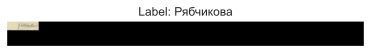

In [53]:
plt.imshow(test_dataset[0]["img"].astype("int"))
plt.title(f"Label: {test_dataset[0]['label']}")
plt.axis("off")
plt.show()

In [54]:
collate_fn = OCRCollateFunction(params["dataset_params"]["config"])
test_loader = DataLoader(
    test_dataset,
    batch_size=1,
    shuffle=False,
    num_workers=params["dataset_params"]["num_gpu"],
    pin_memory=True,
    drop_last=False,
    collate_fn=collate_fn
)

In [55]:
# next(iter(test_loader))

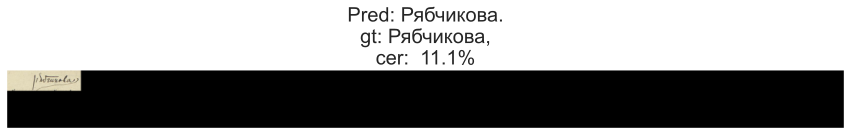

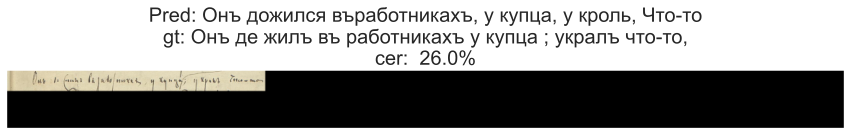

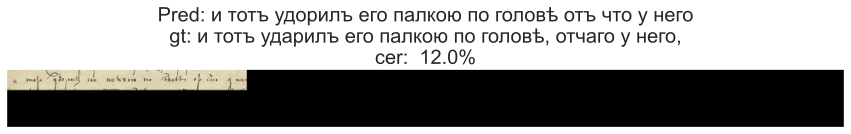

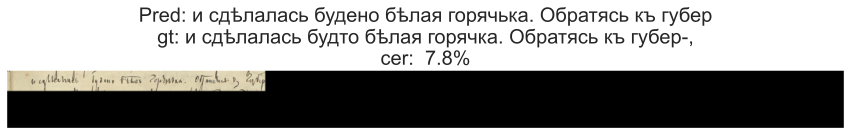

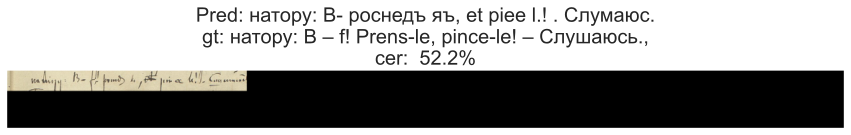

...

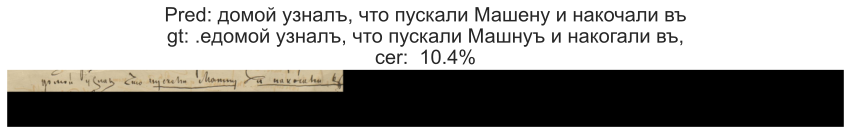

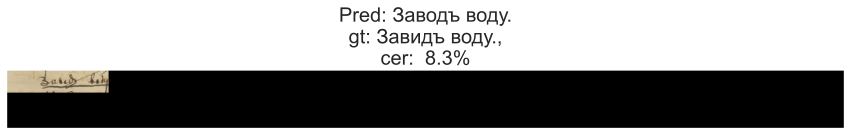

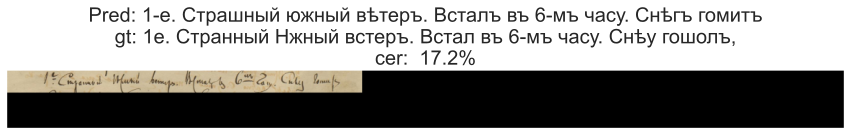

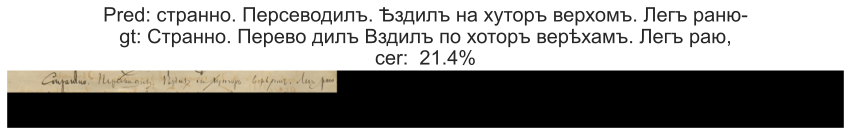

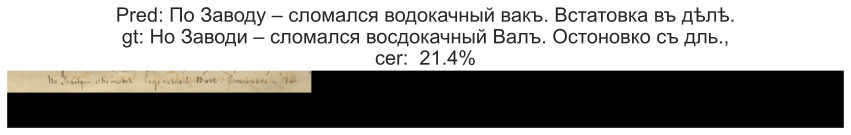

In [28]:
model.eval()
cer_global = 0
n_chars_gt = 0
wer_global = 0
n_words_gt = 0
cer_list = []

with torch.no_grad():
    for ind_batch, batch_data in enumerate(test_loader):
        x = batch_data["imgs"].to(device)
        y = batch_data["labels"].to(device)
        x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
        y_len = batch_data["labels_len"]
        
        #loss_ctc = CTCLoss(blank=test_dataset.tokens["blank"], reduction="sum")

        global_pred = model(x)
        #loss = loss_ctc(global_pred.permute(2, 0, 1), y, x_reduced_len, y_len)
        pred = torch.argmax(global_pred, dim=1).cpu().numpy()

        str_x, str_y = get_str_xy(pred, y.cpu().numpy(), x_reduced_len, y_len)
        
        str_x = str_x[0]
        str_y = str_y[0]
        cer_ = editdistance.eval(str_y, str_x)
        cer_global += cer_
        n_chars_gt += len(str_y)
        cer = cer_ / len(str_y)
        cer_list.append(cer)

        wer_ = edit_wer_from_str(str_y, str_x)
        wer_global += wer_
        n_words_gt += nb_words_from_str(str_y)
        
        plt.figure(figsize=(15, 7))
        plt.imshow(test_dataset_no_pad[ind_batch]["img"].astype("int"))
        plt.axis("off")
        plt.title(f"Pred: {str_x}\ngt: {str_y},\ncer: {cer * 100: .1f}%", fontsize=20)
        plt.show()
plt.close("all")

In [29]:
# v6.1
print(f"Test CER = {cer_global / n_chars_gt}")
print(f"Test WER = {wer_global / n_words_gt}")
print(f"Test n_evaluated_lines: {len(test_loader.dataset)}")

Test CER = 0.1529714653507831
Test WER = 0.4683281412253375
Test n_evaluated_lines: 97


In [29]:
# # v5
# print(f"Test CER = {cer_global / n_chars_gt}")
# print(f"Test WER = {wer_global / n_words_gt}")
# print(f"Test n_evaluated_lines: {len(test_loader.dataset)}")

Test CER = 0.17549881999570907
Test WER = 0.5254413291796469
Test n_evaluated_lines: 97


In [30]:
# # v2
# print(f"Test CER = {cer_global / n_chars_gt}")
# print(f"Test WER = {wer_global / n_words_gt}")
# print(f"Test n_evaluated_lines: {len(test_loader.dataset)}")

Test CER = 0.15932302305223228
Test WER = 0.5064194008559201
Test n_evaluated_lines: 74


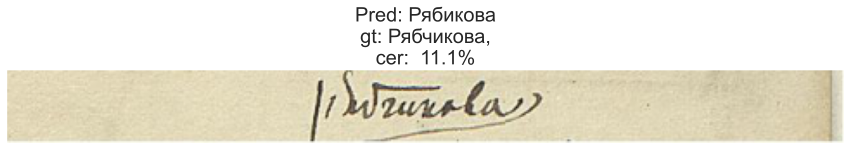

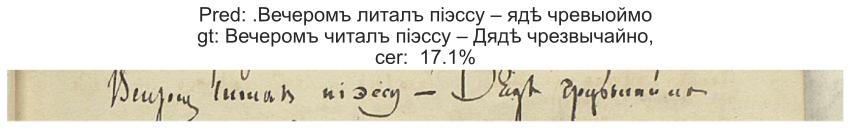

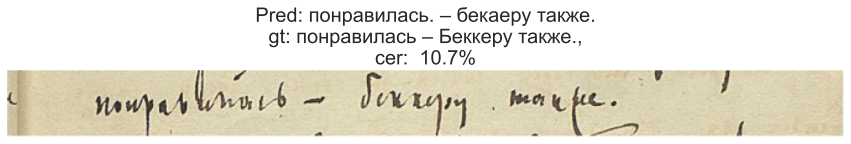

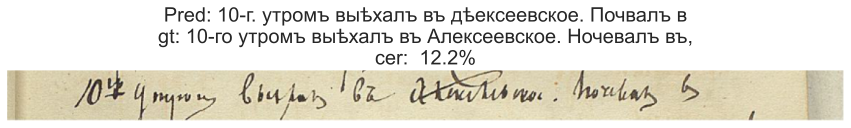

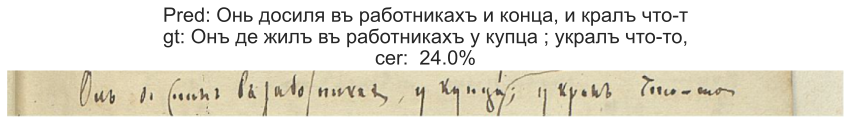

...

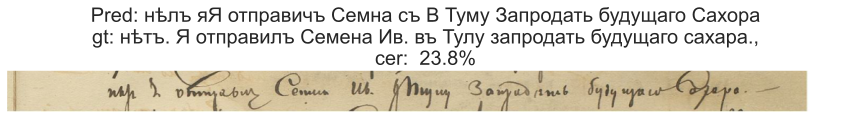

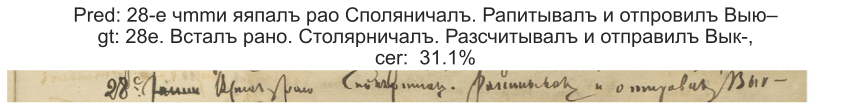

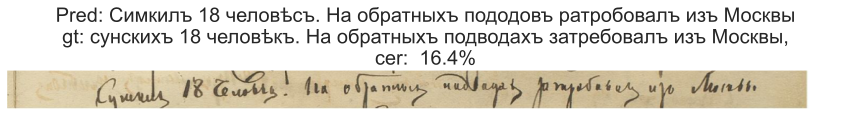

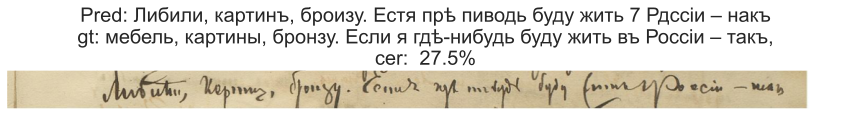

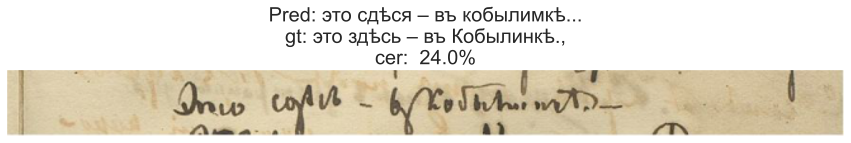

In [38]:
# model.eval()
# cer_global = 0
# n_chars_gt = 0
# wer_global = 0
# n_words_gt = 0
# cer_list = []

# with torch.no_grad():
#     for ind_batch, batch_data in enumerate(test_loader):
#         x = batch_data["imgs"].to(device)
#         y = batch_data["labels"].to(device)
#         x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
#         y_len = batch_data["labels_len"]
        
#         #loss_ctc = CTCLoss(blank=test_dataset.tokens["blank"], reduction="sum")

#         global_pred = model(x)
#         #loss = loss_ctc(global_pred.permute(2, 0, 1), y, x_reduced_len, y_len)
#         pred = torch.argmax(global_pred, dim=1).cpu().numpy()

#         str_x, str_y = get_str_xy(pred, y.cpu().numpy(), x_reduced_len, y_len)
        
#         str_x = str_x[0]
#         str_y = str_y[0]
#         cer_ = editdistance.eval(str_y, str_x)
#         cer_global += cer_
#         n_chars_gt += len(str_y)
#         cer = cer_ / len(str_y)
#         cer_list.append(cer)

#         wer_ = edit_wer_from_str(str_y, str_x)
#         wer_global += wer_
#         n_words_gt += nb_words_from_str(str_y)
        
#         plt.figure(figsize=(15, 7))
#         plt.imshow(test_dataset[ind_batch]["img"])
#         plt.axis("off")
#         plt.title(f"Pred: {str_x}\ngt: {str_y},\ncer: {cer * 100: .1f}%", fontsize=20)
#         plt.show()

In [30]:
# Метрики без паддинга

# print(f"CER = {cer_global / n_chars_gt}")

CER = 0.2340239276334987


In [31]:
# Метрики без паддинга

# print(f"WER = {wer_global / n_words_gt}")

WER = 0.6562054208273894


In [32]:
# print(f"n_evaluated_lines: {len(test_loader.dataset)}")

n_evaluated_lines: 74


### Инференс на train & val

In [56]:
def get_loader(set_name: Literal["train", "valid", "test"], batch_size: int = 1) -> DataLoader:
    dataset = OCRDataset(
        dataset_params,
        "test",  # тут пишем test, чтобы не было аугментации
        "SK-test",
        [{
            "path": dataset_path,
            "set_name": set_name
        }]
    )
    
    dataset.charset = charset
    dataset.tokens = get_tokens(dataset_params, charset)
    dataset.convert_labels()

    collate_fn = OCRCollateFunction(dataset_params["config"])
    loader = DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=dataset_params["num_gpu"],
        pin_memory=True,
        drop_last=False,
        collate_fn=collate_fn
    )

    return loader

In [57]:
def evaluate(set_name: Literal["train", "valid", "test"], batch_size: int = 8):
    loader = get_loader(set_name, batch_size)
    str_preds = []
    str_gt = []
    cers = []
    wers = []

    model.eval()
    cer_global = 0
    n_chars_gt = 0
    wer_global = 0
    n_words_gt = 0

    with torch.no_grad():
        for ind_batch, batch_data in enumerate(tqdm(loader)):
            x = batch_data["imgs"].to(device)
            y = batch_data["labels"].to(device)
            x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
            y_len = batch_data["labels_len"]
            
            #loss_ctc = CTCLoss(blank=test_dataset.tokens["blank"], reduction="sum")
    
            global_pred = model(x)
            #loss = loss_ctc(global_pred.permute(2, 0, 1), y, x_reduced_len, y_len)
            pred = torch.argmax(global_pred, dim=1).cpu().numpy()
    
            str_x_list, str_y_list = get_str_xy(pred, y.cpu().numpy(), x_reduced_len, y_len)

            for str_x, str_y in zip(str_x_list, str_y_list):
                cer_ = editdistance.eval(str_y, str_x)
                cer_global += cer_
                n_chars_gt += len(str_y)
                cer = cer_ / len(str_y)
                cers.append(cer)
        
                wer_ = edit_wer_from_str(str_y, str_x)
                wer_global += wer_
                n_words_gt += nb_words_from_str(str_y)
                wer = wer_ / nb_words_from_str(str_y)
                wers.append(wer)

                str_preds.append(str_x)
                str_gt.append(str_y)
        
    cer = cer_global / n_chars_gt
    wer = wer_global / n_words_gt
    return {"str_preds": str_preds, "str_gt": str_gt, "cer": cer, "wer": wer, "cers": cers, "wers": wers}

In [58]:
eval_train = evaluate("train", batch_size=1)

100%|██████████████████████████████████████████████████████████████████████████████| 2467/2467 [02:48<00:00, 14.61it/s]


In [59]:
eval_val = evaluate("valid", batch_size=1)

100%|████████████████████████████████████████████████████████████████████████████████| 119/119 [00:15<00:00,  7.85it/s]


In [60]:
eval_test = evaluate("test", batch_size=1)

100%|██████████████████████████████████████████████████████████████████████████████████| 97/97 [00:14<00:00,  6.73it/s]


In [61]:
# v6.1 weigths_1000.pt
print(f"Train CER: {eval_train['cer'] * 100:.2f} %")
print(f"Train WER: {eval_train['wer'] * 100:.2f} %")
print(f"Valid CER: {eval_val['cer'] * 100:.2f} %")
print(f"Valid WER: {eval_val['wer'] * 100:.2f} %")
print(f"Test CER: {eval_test['cer'] * 100:.2f} %")
print(f"Test WER: {eval_test['wer'] * 100:.2f} %")

Train CER: 10.59 %
Train WER: 32.45 %
Valid CER: 18.84 %
Valid WER: 56.79 %
Test CER: 17.21 %
Test WER: 52.44 %


In [36]:
# v6.1 best weigths
print(f"Train CER: {eval_train['cer'] * 100:.2f} %")
print(f"Train WER: {eval_train['wer'] * 100:.2f} %")
print(f"Valid CER: {eval_val['cer'] * 100:.2f} %")
print(f"Valid WER: {eval_val['wer'] * 100:.2f} %")
print(f"Test CER: {eval_test['cer'] * 100:.2f} %")
print(f"Test WER: {eval_test['wer'] * 100:.2f} %")

Train CER: 3.73 %
Train WER: 11.06 %
Valid CER: 16.49 %
Valid WER: 50.86 %
Test CER: 15.30 %
Test WER: 46.83 %


In [49]:
# v2
# print(f"Train CER: {eval_train['cer']:.8f}")
# print(f"Train WER: {eval_train['wer']:.8f}")

Train CER: 0.03523157
Train WER: 0.10802469


In [51]:
# print(f"Valid CER: {eval_val['cer']:.8f}")
# print(f"Valid WER: {eval_val['wer']:.8f}")

Valid CER: 0.17738439
Valid WER: 0.53728489


In [53]:
# print(f"Test CER: {eval_test['cer']:.8f}")
# print(f"Test WER: {eval_test['wer']:.8f}")

Test CER: 0.15932302
Test WER: 0.50641940


In [63]:
# with open("eval_train.pkl", "wb") as f:
#     pickle.dump(eval_train, f)
# with open("eval_val.pkl", "wb") as f:
#     pickle.dump(eval_val, f)
# with open("eval_test.pkl", "wb") as f:
#     pickle.dump(eval_test, f)

### Beam search

In [77]:
from utils import beam_search_ctc

In [78]:
beam_width = 5  # Количество путей
blank_id = test_dataset.tokens["blank"]  # Индекс blank символа

In [79]:
with torch.no_grad():
    for ind_batch, batch_data in enumerate(test_loader):
        x = batch_data["imgs"].to(device)
        y = batch_data["labels"].to(device)
        x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
        y_len = batch_data["labels_len"]
        
        # Предсказания модели
        global_pred = model(x)  # (N, C, T), где N - batch, C - классы, T - временные шаги
        probs = global_pred[0].permute(1, 0).unsqueeze(0)  # Преобразуем в (T, C) для одного примера

        # Выполняем beam search
        top_preds = beam_search_ctc(probs, beam_width=beam_width, blank_id=blank_id)

        preds = []
        for i_beam, pred in enumerate(top_preds):
            str_x, str_y = get_str_xy(pred.cpu().numpy().tolist(), y.cpu().numpy(), x_reduced_len, y_len)
            preds.append(str_x[0])
        str_y = str_y[0]

        # # Получаем ground truth (истинную строку)
        # _, str_y = get_str_xy(None, y.cpu().numpy(), x_reduced_len, y_len)
        # str_y = str_y[0]  # Истинная строка

        # print(f"Ground Truth: {str_y}")
        # for idx, pred in enumerate(top_preds):
        #     print(f"Beam {idx + 1}: {pred}")

        # Рассчитываем CER для первого предсказания (лучшего варианта)
        cer_ = editdistance.eval(str_y, preds[0])
        cer_global += cer_
        n_chars_gt += len(str_y)
        cer = cer_ / len(str_y)
        cer_list.append(cer)

        # wer_ = edit_wer_from_str(str_y, preds[0])
        # wer_global += wer_
        # n_words_gt += nb_words_from_str(str_y)

        beam_preds = [f"Beam {idx + 1}: {pred}" for idx, pred in enumerate(preds)]
        plt.figure(figsize=(15, 7))
        plt.imshow(test_dataset[ind_batch]["img"])
        plt.axis("off")
        plt.title("\n".join(beam_preds) + f"\nGT: {str_y},\nCER: {cer * 100: .1f}%", fontsize=20)
        plt.show()

TypeError: 'int' object is not subscriptable

In [9]:
dataset_path = "../Datasets/formatted/SK_lines"
checkpoint_path = "../OCR/line_OCR/ctc/outputs/SK_line_v4_ensemble"  # /i/checkpoints
params_path = "../OCR/line_OCR/ctc/outputs/SK_line_v4_ensemble"  # i/results/params
labels_path = "../OCR/line_OCR/ctc/outputs/SK_line_v4_ensemble/labels.pkl"

In [10]:
with open(labels_path, "rb") as f:
    info = pickle.load(f)
    charset = set(info["charset"])
    charset = sorted(list(charset))

In [11]:
charset

[' ',
 '!',
 '%',
 "'",
 '(',
 ')',
 ',',
 '-',
 '.',
 '/',
 '0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 ':',
 ';',
 '?',
 'A',
 'B',
 'C',
 'D',
 'F',
 'G',
 'H',
 'I',
 'J',
 'L',
 'M',
 'N',
 'O',
 'P',
 'S',
 'T',
 'V',
 'Z',
 '[',
 ']',
 'a',
 'b',
 'c',
 'd',
 'e',
 'f',
 'g',
 'h',
 'i',
 'k',
 'l',
 'm',
 'n',
 'o',
 'p',
 'r',
 's',
 't',
 'u',
 'v',
 'x',
 'y',
 'z',
 '«',
 '°',
 '»',
 '½',
 'ö',
 'û',
 'І',
 'А',
 'Б',
 'В',
 'Г',
 'Д',
 'Е',
 'Ж',
 'З',
 'И',
 'К',
 'Л',
 'М',
 'Н',
 'О',
 'П',
 'Р',
 'С',
 'Т',
 'У',
 'Ф',
 'Х',
 'Ц',
 'Ч',
 'Ш',
 'Щ',
 'Э',
 'Ю',
 'Я',
 'а',
 'б',
 'в',
 'г',
 'д',
 'е',
 'ж',
 'з',
 'и',
 'й',
 'к',
 'л',
 'м',
 'н',
 'о',
 'п',
 'р',
 'с',
 'т',
 'у',
 'ф',
 'х',
 'ц',
 'ч',
 'ш',
 'щ',
 'ъ',
 'ы',
 'ь',
 'э',
 'ю',
 'я',
 'ё',
 'і',
 'ї',
 'Ѣ',
 'ѣ',
 'Ѳ',
 'ѳ',
 '–',
 '†',
 '…',
 '№']

In [12]:
gt = info["ground_truth"]
gt["test"]

{'test_0.jpg': {'text': 'Рябчикова'},
 'test_1.jpg': {'text': 'Вечеромъ читалъ піэссу – Дядѣ чрезвычайно'},
 'test_2.jpg': {'text': 'понравилась – Беккеру также.'},
 'test_3.jpg': {'text': '10-го утромъ выѣхалъ въ Алексеевское. Ночевалъ въ'},
 'test_4.jpg': {'text': 'Онъ де жилъ въ работникахъ у купца ; укралъ что-то'},
 'test_5.jpg': {'text': 'и тотъ ударилъ его палкою по головѣ, отчаго у него'},
 'test_6.jpg': {'text': 'и сдѣлалась будто бѣлая горячка. Обратясь къ губер-'},
 'test_7.jpg': {'text': 'натору: В – f! Prens-le, pince-le! – Слушаюсь.'},
 'test_8.jpg': {'text': 'Болѣе никакихъ распоряженій и не было сдѣлано. Впрочемъ,'},
 'test_9.jpg': {'text': 'и часовые возвратились на прежніе мѣста – ибо'},
 'test_10.jpg': {'text': 'въ противномъ случаѣ и острожные остались бы безъ'},
 'test_11.jpg': {'text': 'всякаго караула.'},
 'test_12.jpg': {'text': '1856 годъ. Май'},
 'test_13.jpg': {'text': 'правой сторонѣ парка отъ дома къ рѣкѣ. Около'},
 'test_14.jpg': {'text': 'дома проводитъ ш

In [13]:
MIN_HEIGHT = 130 #139
MIN_WIDTH = 1650


with open(Path(params_path) / f"{1}/results/params", 'r') as params_file:
    params = json.load(params_file)

# делаем паддинг изображений, чтобы приблизить размеры к тому, что было на обучении
dataset_params = params["dataset_params"]
if "padding" not in dataset_params["config"]["constraints"]:
    print("Add padding")
    dataset_params["config"]["constraints"].append("padding")
    dataset_params["config"]["padding"] = {}
dataset_params["config"]["padding"]["min_height"] = MIN_HEIGHT
dataset_params["config"]["padding"]["min_width"] = MIN_WIDTH

test_dataset = OCRDataset(
    dataset_params,
    "test",
    "SK-test",
    [{
        "path": dataset_path,
        "set_name": "test"
    }]
)

test_dataset.charset = charset
test_dataset.tokens = get_tokens(params["dataset_params"], charset)
test_dataset.convert_labels()

Add padding


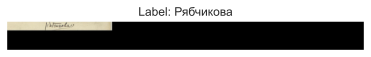

In [14]:
plt.imshow(test_dataset[0]["img"].astype("int"))
plt.title(f"Label: {test_dataset[0]['label']}")
plt.axis("off")
plt.show()

In [15]:
collate_fn = OCRCollateFunction(params["dataset_params"]["config"])
test_loader = DataLoader(
    test_dataset,
    batch_size=1,
    shuffle=False,
    num_workers=params["dataset_params"]["num_gpu"],
    pin_memory=True,
    drop_last=False,
    collate_fn=collate_fn
)

In [16]:
N_MODELS = 6

models = []

for i in range(1, N_MODELS + 1):
    with open(Path(params_path) / f"{i}/results/params", 'r') as params_file:
        params = json.load(params_file)
    checkpoint_path_i = Path(checkpoint_path) / f"{i}/checkpoints"
    checkpoint_name = sorted(os.listdir(checkpoint_path_i))[0]
    print(f"{i}: loading {checkpoint_name}")
    checkpoint = torch.load(checkpoint_path_i / checkpoint_name, weights_only=False)
    models.append(
        LineVAN(
            params["model_params"],
            encoder_state_dict=checkpoint["encoder_state_dict"],
            decoder_state_dict=checkpoint["decoder_state_dict"]
        ).to(device)
    )

1: loading best_2960.pt
2: loading best_2996.pt
3: loading best_2954.pt
4: loading best_2956.pt
5: loading best_2974.pt
6: loading best_2958.pt


In [17]:
for model in models:
    model.eval()

cers_global = [0] * N_MODELS
n_chars_gt = [0] * N_MODELS
wers_global = [0] * N_MODELS
n_words_gt = [0] * N_MODELS

with torch.no_grad():
    for ind_batch, batch_data in enumerate(tqdm(test_loader)):
        x = batch_data["imgs"].to(device)
        y = batch_data["labels"].to(device)
        x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
        y_len = batch_data["labels_len"]
        
        #loss_ctc = CTCLoss(blank=test_dataset.tokens["blank"], reduction="sum")
        str_x_list = []
        cer_list = []
        for i, model in enumerate(models):
            global_pred = model(x)
            #loss = loss_ctc(global_pred.permute(2, 0, 1), y, x_reduced_len, y_len)
            pred = torch.argmax(global_pred, dim=1).cpu().numpy()
    
            str_x, str_y = get_str_xy(pred, y.cpu().numpy(), x_reduced_len, y_len)
            
            str_x = str_x[0]
            str_y = str_y[0]
            edit = editdistance.eval(str_y, str_x)
            cers_global[i] += edit
            n_chars_gt[i] += len(str_y)
            wers_global[i] += edit_wer_from_str(str_y, str_x)
            n_words_gt[i] += nb_words_from_str(str_y)

            cer_list.append(edit / len(str_y))

            str_x_list.append(str_x)
        # plt.figure(figsize=(20, 30))
        # plt.imshow(test_dataset[ind_batch]["img"])
        # plt.axis("off")
        # plt.title(f"gt: {str_y}\n" + "\n".join([f"Pred {i + 1}: {str_x_list[i]} (cer: {cer_list[i] * 100: .1f}%)" for i in range(N_MODELS)]), fontsize=20)
        # plt.show()

100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:20<00:00,  3.67it/s]


In [18]:
cers = [cers_global[i] / n_chars_gt[i] for i in range(N_MODELS)]
cers

[0.2028012839217975,
 0.19463087248322147,
 0.20338488473883864,
 0.2007586810621535,
 0.2025094835132769,
 0.20747009045812664]

In [19]:
wers = [wers_global[i] / n_words_gt[i] for i in range(N_MODELS)]
wers

[0.5763195435092725,
 0.5520684736091298,
 0.572039942938659,
 0.5634807417974322,
 0.5592011412268189,
 0.5734664764621968]

In [18]:
# Метрики без паддинга

# cers = [cers_global[i] / n_chars_gt[i] for i in range(N_MODELS)]
# cers

[0.26670557338780276,
 0.26758097461336444,
 0.25474175663845927,
 0.2579515611321856,
 0.2725415815582142,
 0.2702071782900496]

In [19]:
# Метрики без паддинга

# wers = [wers_global[i] / n_words_gt[i] for i in range(N_MODELS)]
# wers

[0.6776034236804565,
 0.7061340941512125,
 0.6533523537803139,
 0.6690442225392297,
 0.6990014265335235,
 0.6776034236804565]

In [46]:
n_chars_gt

[3427, 3427, 3427, 3427, 3427, 3427]

In [47]:
n_words_gt

[701, 701, 701, 701, 701, 701]

### Усреднение вероятностей

In [48]:
def get_ensemble_pred(models, x):
    probs = []
    for model in models:
        prob = torch.exp(model(x))
        probs.append(prob.cpu().numpy())
    
    ens_prob = np.mean(np.array(probs), axis=0)
    return np.argmax(ens_prob, axis=1)

In [49]:
for model in models:
    model.eval()

cer_global = 0
n_chars_gt = 0
wer_global = 0
n_words_gt = 0

with torch.no_grad():
    for ind_batch, batch_data in enumerate(tqdm(test_loader)):
        x = batch_data["imgs"].to(device)
        y = batch_data["labels"].to(device)
        x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
        y_len = batch_data["labels_len"]
        
        pred = get_ensemble_pred(models, x)
        str_x, str_y = get_str_xy(pred, y.cpu().numpy(), x_reduced_len, y_len)
        
        str_x = str_x[0]
        str_y = str_y[0]
        edit = editdistance.eval(str_y, str_x)
        cer_global += edit
        n_chars_gt += len(str_y)
        wer_global += edit_wer_from_str(str_y, str_x)
        n_words_gt += nb_words_from_str(str_y)

100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:36<00:00,  2.02it/s]


In [50]:
cer_ens_prob = cer_global / n_chars_gt
wer_ens_prob = wer_global / n_words_gt

print(f"CER = {cer_ens_prob}")
print(f"WER = {wer_ens_prob}")

CER = 0.19258826962357747
WER = 0.5520684736091298


In [51]:
np.min(cers), np.mean(cers), np.min(wers), np.mean(wers)

(0.19463087248322147,
 0.2019258826962358,
 0.5520684736091298,
 0.5660960532572515)

### Усреднение весов

In [53]:
# Инициализируем модель для усреднённых весов
average_model = LineVAN(params["model_params"]).to(device)

# Получаем список параметров каждой модели
model_params = [model.state_dict() for model in models]

# Усредняем параметры
averaged_state_dict = OrderedDict()

for key in model_params[0]:  # Проходим по ключам параметров первой модели
    # Усредняем веса по всем моделям
    avg_param = torch.stack([model_params[i][key] for i in range(N_MODELS)], dim=0).mean(dim=0)
    averaged_state_dict[key] = avg_param

# Задаём усреднённые веса для новой модели
average_model.load_state_dict(averaged_state_dict)

encoder_state_dict is None
decoder_state_dict is None


<All keys matched successfully>

In [54]:
average_model.eval()

cer_global = 0
n_chars_gt = 0
wer_global = 0
n_words_gt = 0

with torch.no_grad():
    for ind_batch, batch_data in enumerate(tqdm(test_loader)):
        x = batch_data["imgs"].to(device)
        y = batch_data["labels"].to(device)
        x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
        y_len = batch_data["labels_len"]
        
        global_pred = average_model(x)
        pred = torch.argmax(global_pred, dim=1).cpu().numpy()
        str_x, str_y = get_str_xy(pred, y.cpu().numpy(), x_reduced_len, y_len)
        
        str_x = str_x[0]
        str_y = str_y[0]
        edit = editdistance.eval(str_y, str_x)
        cer_global += edit
        n_chars_gt += len(str_y)
        wer_global += edit_wer_from_str(str_y, str_x)
        n_words_gt += nb_words_from_str(str_y)

100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:12<00:00,  6.05it/s]


In [55]:
cer_ens_w = cer_global / n_chars_gt
wer_ens_w = wer_global / n_words_gt

print(f"CER = {cer_ens_w}")
print(f"WER = {wer_ens_w}")

CER = 1.0
WER = 1.0


### Неопределенность

In [52]:
def calculate_uncertainty(predictions: list[str]) -> float:
    """
    Рассчитывает неопределенность как средний CER между предсказаниями разных моделей.
    """
    n_models = len(predictions)
    total_distance = 0
    num_comparisons = 0

    # Вычисляем пару CER между предсказаниями каждой модели
    for i in range(n_models):
        for j in range(i + 1, n_models):
            total_distance += editdistance.eval(predictions[i], predictions[j]) / max(len(predictions[i]), len(predictions[j]))
            num_comparisons += 1

    # Возвращаем среднее значение CER
    return total_distance / num_comparisons

uncertainty_scores = []
predictions_by_model = [[] for _ in range(N_MODELS)]

# Получаем предсказания всех моделей
with torch.no_grad():
    for ind_batch, batch_data in enumerate(tqdm(test_loader)):
        x = batch_data["imgs"].to(device)
        y = batch_data["labels"].to(device)
        x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
        y_len = batch_data["labels_len"]
        
        str_x_list = []
        cers_per_model = []

        # Проходим по всем моделям и собираем предсказания
        for i, model in enumerate(models):
            global_pred = model(x)
            pred = torch.argmax(global_pred, dim=1).cpu().numpy()
            str_x, str_y = get_str_xy(pred, y.cpu().numpy(), x_reduced_len, y_len)
            str_x = str_x[0]
            str_y = str_y[0]
            str_x_list.append(str_x)  # Предсказанная строка от модели

            cer = editdistance.eval(str_y, str_x) / len(str_y)
            cers_per_model.append(cer)

        # Рассчитываем неопределенность для текущей строки
        uncertainty = calculate_uncertainty(str_x_list)

        # Сохраняем результаты: исходная строка, предсказания и её неопределенность
        uncertainty_scores.append((str_y, str_x_list, uncertainty, cers_per_model))

# Ранжируем строки по неопределенности (от самой неопределённой к наименее)
uncertainty_scores.sort(key=lambda x: x[2], reverse=True)

# Выводим строки с наибольшей неопределенностью
for original, preds, uncertainty, cers in uncertainty_scores:
    print(f"GT     : {original}")
    for i, (pred, cer) in enumerate(zip(preds, cers)):
        print(f"Model {i + 1}: {pred} | (CER = {cer * 100:.2f})")
    print(f"Uncertainty (avg CER between models): {uncertainty}")
    print(f"Average CER: {np.mean(cers) * 100 :.2f}")
    print()


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:40<00:00,  1.85it/s]

GT     : надписи Самойлову. Надпись:
Model 1: падпися самой лову. Нюдить | (CER = 29.63)
Model 2: падпиния Саной лову. Жодить | (CER = 37.04)
Model 3: наднисія Самнойлову. Надить | (CER = 25.93)
Model 4: падтися Самной лову. Нюдить | (CER = 33.33)
Model 5: подпися саной пову. Подись | (CER = 40.74)
Model 6: падпя Самой пову. Наднить | (CER = 33.33)
Uncertainty (avg CER between models): 0.2637226970560304
Average CER: 33.33

GT     : За Спасеніе погибавшихъ – таланту В.В.
Model 1: За снаеніе почибавмисъ – талатину 14. В | (CER = 34.21)
Model 2: Да снасеніе почебавшикъ – талатицу В. В. | (CER = 26.32)
Model 3: За снасеніе погибавинисъ – таланицъ 1ъ. Въ | (CER = 31.58)
Model 4: За снастіе погибавмихъ – таланину 18. Въ | (CER = 28.95)
Model 5: За спастіе почибовмися – таланиц 1К.В | (CER = 34.21)
Model 6: За спасетіе почибавмикя – талану 1Въ. Въ | (CER = 28.95)
Uncertainty (avg CER between models): 0.25304639804639806
Average CER: 30.70

GT     : Дѣло въ Госуд. Советѣ. Декабрь Торги на вин

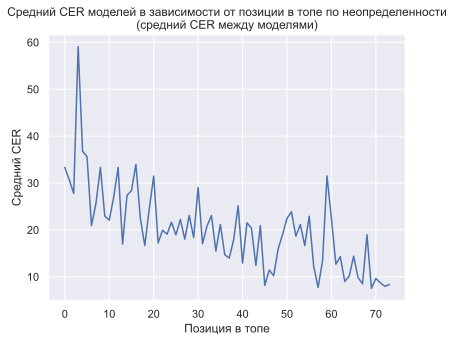

In [53]:
mean_cers = []

for original, preds, uncertainty, cers in uncertainty_scores:
    mean_cers.append(np.mean(cers) * 100)

plt.plot(mean_cers)
plt.title("Средний CER моделей в зависимости от позиции в топе по неопределенности\n(средний CER между моделями)")
plt.xlabel("Позиция в топе")
plt.ylabel("Средний CER")
plt.savefig("./ensemble_uncertainty_lev.pdf", bbox_inches='tight')
plt.show()

In [65]:
from scipy.stats import entropy

def calculate_entropy(probs: torch.Tensor) -> float:
    """
    Рассчитывает энтропию для вероятностных предсказаний.
    
    :param probs: Тензор вероятностей.
    :return: список из энтропий по всем элементам.
    """
    probs_np = probs.cpu().numpy()
    entropies = entropy(probs_np, axis=0)
    return list(entropies)

uncertainty_scores = []

# Получаем предсказания всех моделей
with torch.no_grad():
    for ind_batch, batch_data in enumerate(tqdm(test_loader)):
        x = batch_data["imgs"].to(device)
        y = batch_data["labels"].to(device)
        x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
        y_len = batch_data["labels_len"]
        
        entropy_list = []
        predictions_per_model = []  # Для сохранения предсказаний всех моделей
        cers_per_model = []
        
        # Проходим по всем моделям и собираем вероятности предсказаний
        for i, model in enumerate(models):
            global_pred = model(x)
            probs = torch.exp(global_pred)  # Применяем softmax для получения вероятностей
            entropy_list += calculate_entropy(probs[0])  # Рассчитываем энтропию для данной модели
            
            # Получаем предсказания каждой модели
            pred = torch.argmax(global_pred, dim=1).cpu().numpy()
            str_x, str_y = get_str_xy(pred, y.cpu().numpy(), x_reduced_len, y_len)
            str_x = str_x[0]
            str_y = str_y[0]
            predictions_per_model.append(str_x)  # Сохраняем предсказание текущей модели

            cer = editdistance.eval(str_y, str_x) / len(str_y)
            cers_per_model.append(cer)

        # Рассчитываем среднюю энтропию по моделям для текущей строки
        avg_entropy = np.mean(entropy_list)
        
        # Сохраняем исходную строку, предсказания всех моделей и среднюю энтропию
        uncertainty_scores.append((str_y, predictions_per_model, avg_entropy, cers_per_model))

# Ранжируем строки по энтропии (от самой неопределённой к наименее)
uncertainty_scores.sort(key=lambda x: x[2], reverse=True)

# Выводим строки с наибольшей неопределенностью, включая предсказания всех моделей
for original, predictions, avg_entropy, cers in uncertainty_scores:
    print(f"GT     : {original}")
    for i, (pred, cer) in enumerate(zip(predictions, cers)):
        print(f"Model {i + 1}: {pred} | (CER = {cer * 100:.2f})")
    print(f"Average Entropy: {avg_entropy}")
    print(f"Average CER: {np.mean(cers) * 100 :.2f}")
    print()

100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:24<00:00,  3.02it/s]

GT     : Рябчикова
Model 1: рабикова | (CER = 33.33)
Model 2: рябикова | (CER = 22.22)
Model 3: рябикова | (CER = 22.22)
Model 4: Рябикова | (CER = 11.11)
Model 5: Рябикова | (CER = 11.11)
Model 6: рябикова | (CER = 22.22)
Average Entropy: 1.455026388168335
Average CER: 20.37

GT     : 1856 годъ. Май
Model 1: 1856. Год. Май. | (CER = 28.57)
Model 2: 1856. Годъ Маn. | (CER = 35.71)
Model 3: 1856. год. Ма. | (CER = 21.43)
Model 4: 1856. Годъ. Ман. | (CER = 28.57)
Model 5: 1856. год. Мат. | (CER = 28.57)
Model 6: 1856 годъ Мат. | (CER = 21.43)
Average Entropy: 1.3587337732315063
Average CER: 27.38

GT     : всякаго караула.
Model 1: всякаю караува. | (CER = 18.75)
Model 2: всякагю караува. | (CER = 12.50)
Model 3: всякоо караува. | (CER = 18.75)
Model 4: всякаю кародва. | (CER = 31.25)
Model 5: всякаго караува. | (CER = 6.25)
Model 6: всякого караува. | (CER = 12.50)
Average Entropy: 1.104146122932434
Average CER: 16.67

GT     : Возвратился въ Москву.
Model 1: возврашнся въ Москву. | (CE

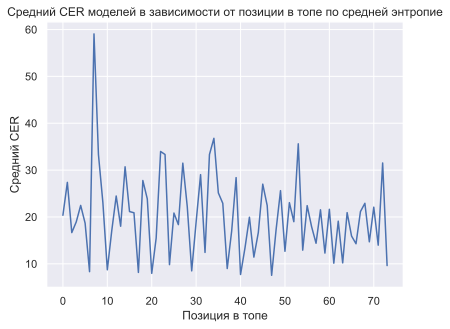

In [66]:
mean_cers = []

for original, preds, uncertainty, cers in uncertainty_scores:
    mean_cers.append(np.mean(cers) * 100)

plt.plot(mean_cers)
plt.title("Средний CER моделей в зависимости от позиции в топе по средней энтропие")
plt.xlabel("Позиция в топе")
plt.ylabel("Средний CER")
plt.show()

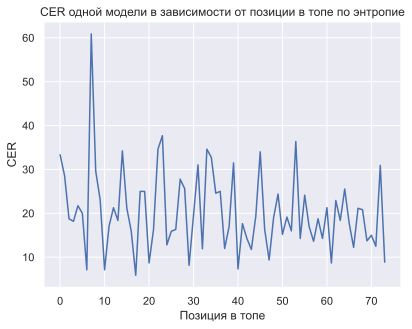

In [64]:
cers_1_model = []

for original, preds, uncertainty, cers in uncertainty_scores:
    cers_1_model.append(cers[0] * 100)

plt.plot(cers_1_model)
plt.title("CER одной модели в зависимости от позиции в топе по энтропие")
plt.xlabel("Позиция в топе")
plt.ylabel("CER")
plt.show()

In [67]:
def calculate_std(probs: torch.Tensor) -> float:
    """
    Рассчитывает std для вероятностных предсказаний.
    
    :param probs: Тензор вероятностей
    :return: список из std по всем элементам.
    """
    probs_np = probs.cpu().numpy()
    std = probs_np.std(axis=0)
    return list(std)

uncertainty_scores = []

# Получаем предсказания всех моделей
with torch.no_grad():
    for ind_batch, batch_data in enumerate(tqdm(test_loader)):
        x = batch_data["imgs"].to(device)
        y = batch_data["labels"].to(device)
        x_reduced_len = [s[1] for s in batch_data["imgs_reduced_shape"]]
        y_len = batch_data["labels_len"]
        
        std_list = []
        predictions_per_model = []  # Для сохранения предсказаний всех моделей
        cers_per_model = []
        
        # Проходим по всем моделям и собираем вероятности предсказаний
        for i, model in enumerate(models):
            global_pred = model(x)
            probs = torch.exp(global_pred)  # Применяем softmax для получения вероятностей
            std_list += calculate_std(probs[0])  # Рассчитываем std для данной модели
            
            # Получаем предсказания каждой модели
            pred = torch.argmax(global_pred, dim=1).cpu().numpy()
            str_x, str_y = get_str_xy(pred, y.cpu().numpy(), x_reduced_len, y_len)
            str_x = str_x[0]
            str_y = str_y[0]
            predictions_per_model.append(str_x)  # Сохраняем предсказание текущей модели

            cer = editdistance.eval(str_y, str_x) / len(str_y)
            cers_per_model.append(cer)

        # Рассчитываем среднюю энтропию по моделям для текущей строки
        avg_std = np.mean(std_list)
        
        # Сохраняем исходную строку, предсказания всех моделей и среднюю энтропию
        uncertainty_scores.append((str_y, predictions_per_model, avg_std, cers_per_model))

# Ранжируем строки по энтропии (от самой неопределённой к наименее)
uncertainty_scores.sort(key=lambda x: x[2], reverse=True)

# Выводим строки с наибольшей неопределенностью, включая предсказания всех моделей
for original, predictions, avg_std, cers in uncertainty_scores:
    print(f"GT     : {original}")
    for i, (pred, cer) in enumerate(zip(predictions, cers)):
        print(f"Model {i + 1}: {pred} | (CER = {cer * 100:.2f})")
    print(f"Average std: {avg_std}")
    print(f"Average CER: {np.mean(cers) * 100 :.2f}")
    print()

100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:23<00:00,  3.19it/s]

GT     : Ковскимъ, который явился съ предложеніемъ отъ
Model 1: Кавскимъ, который – явился съ предноженіемъ отъ | (CER = 8.89)
Model 2: Кавскимъ, который – явился съ предсноженіемъ отъ | (CER = 11.11)
Model 3: Кавскимъ, который – явился съ предноженіемъ отъ | (CER = 8.89)
Model 4: Кавскимъ, который – явился съ предноженіемъ отъ | (CER = 8.89)
Model 5: Кавскимъ, поторый – явился съ предноженіемъ омъ | (CER = 13.33)
Model 6: Кавскимъ, косторый явился съ предноженіемъ отъ | (CER = 6.67)
Average std: 0.08053130656480789
Average CER: 9.63

GT     : нѣсколько потолстѣлъ и въ голосѣ нѣсколько перемѣнился,
Model 1: нѣсколько потолестѣлъ и въ голось замѣтжна перемела | (CER = 30.91)
Model 2: нѣсколько потолестѣлъ и въ гологь замѣжна перемела | (CER = 32.73)
Model 3: нѣсколько потолстѣлъ и въ гологю замѣжа перемили | (CER = 29.09)
Model 4: нѣсколько потолестѣлъ и въ гологю замѣжа перемела | (CER = 32.73)
Model 5: нѣсколько потолестѣлъ и въ гологю замѣжа перемели | (CER = 32.73)
Model 6: нѣскольк

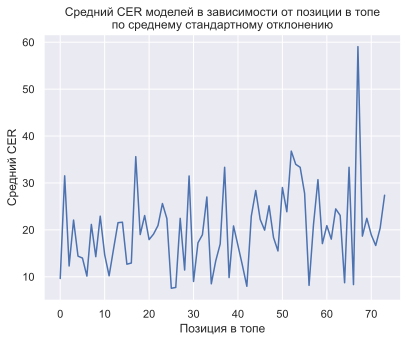

In [69]:
mean_cers = []

for original, preds, uncertainty, cers in uncertainty_scores:
    mean_cers.append(np.mean(cers) * 100)

plt.plot(mean_cers)
plt.title("Средний CER моделей в зависимости от позиции в топе\nпо среднему стандартному отклонению")
plt.xlabel("Позиция в топе")
plt.ylabel("Средний CER")
plt.show()